<center>
<p><img src="https://mcd.unison.mx/wp-content/themes/awaken/img/logo_mcd.png" width="150">
</p>

<h1> Matemáticas para ciencia de datos</h1>


<h3>Ejercicio obligatorio</h3>

<h4> Alumna: Diana Laura Ballesteros Valenzuela</h4>

<img src="https://identidadbuho.unison.mx/wp-content/uploads/2019/06/letragrama-cmyk-72.jpg" width="150">

</center>

In [1]:
import numpy as np
from matplotlib import pyplot
import matplotlib.pyplot as plt
from IPython import display
from sklearn.preprocessing import StandardScaler
import pandas as pd
import plotly.express as px
import xlrd
import nbformat
from numpy.linalg import matrix_rank

**1. Descarga y exploración inicial**
* Descarga el archivo adjunto MARGINACION_AGEBS_2020.xls y crea un dataframe de nombre df_INDICE.

In [2]:
url = "MARGINACION_AGEBS_2020.xls"
df_INDICE = pd.read_excel(url)

In [3]:
df_INDICE= pd.read_excel("MARGINACION_AGEBS_2020.xls")

In [4]:
df_INDICE

,CVE_AGEB,ENT,NOM_ENT,MUN,NOM_MUN,LOC,NOM_LOC,AGEB,POB_TOT,P6A14NAE,...,OVSEE,OVSAE,OVPT,OVHAC,OVSREF,OVSINT,OSCEL,IM_2020,GM_2020,IMN_2020
0,0100100010017,1,Aguascalientes,1,Aguascalientes,1,Aguascalientes,0017,2237,13.076923,...,0.357942,0.000000,0.089485,32.035794,19.239374,71.543624,3.445190,119.325886,Medio,0.932129
1,010010001006A,1,Aguascalientes,1,Aguascalientes,1,Aguascalientes,006A,1411,0.800000,...,0.000000,0.000000,0.000000,2.055280,0.000000,2.763997,0.566974,125.820757,Muy bajo,0.982865
2,0100100010106,1,Aguascalientes,1,Aguascalientes,1,Aguascalientes,0106,2962,3.157895,...,0.000000,0.000000,0.135318,5.538669,0.371496,17.223911,0.810537,125.749891,Muy bajo,0.982311
3,0100100010163,1,Aguascalientes,1,Aguascalientes,1,Aguascalientes,0163,2698,2.788845,...,0.000000,0.000000,0.148478,12.008895,1.890289,34.395849,1.000741,125.074122,Muy bajo,0.977032
4,0100100010182,1,Aguascalientes,1,Aguascalientes,1,Aguascalientes,0182,2218,1.759531,...,0.000000,0.000000,0.452489,0.588235,0.226860,1.719457,0.271493,126.020458,Muy bajo,0.984425
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50785,3205700010408,32,Zacatecas,57,Trancoso,1,Trancoso,0408,203,12.244898,...,0.000000,0.985222,6.403941,45.320197,25.615764,98.029557,5.418719,113.892631,Muy alto,0.889687
50786,3205800010015,32,Zacatecas,58,Santa María de la Paz,1,Santa María de la Paz,0015,707,5.737705,...,0.285714,0.000000,1.285714,27.000000,6.857143,55.714286,10.571429,119.817647,Medio,0.935971
50787,320580001002A,32,Zacatecas,58,Santa María de la Paz,1,Santa María de la Paz,002A,845,6.481481,...,0.000000,0.476190,0.595238,15.476190,10.238095,57.976190,12.380952,120.284585,Medio,0.939618
50788,3205800010104,32,Zacatecas,58,Santa María de la Paz,1,Santa María de la Paz,0104,169,2.631579,...,0.000000,0.000000,0.000000,42.073171,10.365854,77.439024,1.829268,121.915816,Bajo,0.952361


# **Diccionario de variables:**

* *CVE_AGEB*: Clave única por área geoestadística municipal.
* *ENT*: Clave por entidad
* *NOM_ENT*: Nombre de la entidad federativa de México.
* *MUN*: Municipio
* *NOM_MUN*: Nombre del municipio.
* *LOC*: Localidad
* *NOM_LOC*: Nombre de localidad
* *AGEB*: Área geoestadística municipal
* *POB_TOTAL*: Población total.
* *P6A14NAE*: Porcentaje de población de 6 a 14 que no asiste a la escuela
* *SBASC*: Porcentaje de población de 15 años o más sin educación básica
* *PSDSS*: Porcentaje de población sin derechohabiencia a los servicios de salud
* *OVSDE*: Porcentaje de ocupantes en viviendas sin drenaje ni excusado
* *OVSEE*: Porcentaje de ocupantes en viviendas sin energía eléctrica
* *OVSAE*: Porcentaje de ocupantes en viviendas sin agua entubada
* *OVPT*: Porcentaje de ocupantes en viviendas con piso de tierra
* *OVHAC*: Porcentaje de ocupantes en viviendas con hacinamiento
* *OVSREF*: Porcentaje de ocupantes en viviendas sin refrigerador
* *OVSINT*: Porcentaje de ocupantes en viviendas sin internet
* *OSCEL*: Porcentaje de ocupantes en viviendas sin celular
* *IM_2020*: Índice de marginación
* *GM_2020*: Grado de marginación, donde 98-1 es muy bajo, 95-98 es bajo, y 93-94 es medio
* *IMN_2020*: Índice de marginación normalizado

Una vez creado el *df_INDICE*, se genera un vector que contenga el nombre de las variables que componen el índice de marginación.

In [5]:
features = ['P6A14NAE', 'SBASC', 'PSDSS', 'OVSDE', 'OVSEE', 'OVSAE', 'OVPT', 'OVHAC', 'OVSREF', 'OVSINT', 'OSCEL']

Después, a través de ese vector, se crea un nuevo data frame, *df_FEATURES*, que contenga únicamente las variables que forman el índice de marginación.

In [6]:
df_FEATURES = df_INDICE[features]
print(df_FEATURES)

        P6A14NAE      SBASC      PSDSS      OVSDE     OVSEE     OVSAE  \
0      13.076923  22.976680  20.161290   0.000000  0.357942  0.000000   
1       0.800000   5.203406  21.093750   0.000000  0.000000  0.000000   
2       3.157895   3.525488  13.193505   0.000000  0.000000  0.000000   
3       2.788845   7.623049  12.638992   0.000000  0.000000  0.000000   
4       1.759531   2.951192  18.366426   0.000000  0.000000  0.000000   
...          ...        ...        ...        ...       ...       ...   
50785  12.244898  33.057851  20.689655  10.837438  0.000000  0.985222   
50786   5.737705  39.801980  22.065064   0.000000  0.285714  0.000000   
50787   6.481481  42.987805  12.899408   0.000000  0.000000  0.476190   
50788   2.631579  20.792079  17.365269   0.000000  0.000000  0.000000   
50789   0.000000  37.853107   5.327869   0.000000  1.632653  0.000000   

           OVPT      OVHAC     OVSREF     OVSINT      OSCEL  
0      0.089485  32.035794  19.239374  71.543624   3.445190  

*Instrucción*:

Explora tus datos df_INDICE.

In [7]:
fig = px.scatter(df_INDICE,
                 x="IM_2020", 
                 y="P6A14NAE", 
                 color_discrete_sequence=['red'], 
                 marginal_x='violin', 
                 marginal_y='violin',
                 opacity=0.6,
                 title = 'Gráfica 1: Porcentaje de población de 15 años o más sin educación básica en funciób del Índice de marginación: 2020'
                )
fig.show()

In [8]:
fig = px.scatter(df_INDICE,
                 x="NOM_ENT", 
                 y="OVSEE", 
                 color_discrete_sequence=['green'], 
                 marginal_x='violin', 
                 marginal_y='violin',
                 opacity=0.6,
                title = 'Gráfica 2: Porcentaje de ocupantes en viviendas sin energía eléctrica por estado: 2020'
                )
fig.show()

*Instrucción*: 

Construye 3 matrices con 3 columnas de df_INDICE de rango 1, 2 y 3, de dimensiones $50790×3$. Grafica esas tres matrices de datos en 3D. Localiza en la gráfica al Ran $A^{T}$.

La indicación anterior se realiza con *df_FEATURES*, dado que es una submatriz de la matriz *df_INDICE*.

Usando el comando 
```
matrix_rank()
```
conocemos que el *rango* de la matriz *df_FEATURES* es $11$. Es decir, todas las columnas de dicha matriz son linealmente independientes. Por lo tanto, puede contruirse una submatriz de dimensión $50790×3$ y rango $3$, pero no con rangos menores.

In [9]:
matrix_rank(df_FEATURES)
FEATURES_2 = ['P6A14NAE', 'SBASC', 'PSDSS']
df_FEATURES_RANK3 = df_FEATURES[FEATURES_2]
print(df_FEATURES_RANK3)

        P6A14NAE      SBASC      PSDSS
0      13.076923  22.976680  20.161290
1       0.800000   5.203406  21.093750
2       3.157895   3.525488  13.193505
3       2.788845   7.623049  12.638992
4       1.759531   2.951192  18.366426
...          ...        ...        ...
50785  12.244898  33.057851  20.689655
50786   5.737705  39.801980  22.065064
50787   6.481481  42.987805  12.899408
50788   2.631579  20.792079  17.365269
50789   0.000000  37.853107   5.327869

[50790 rows x 3 columns]


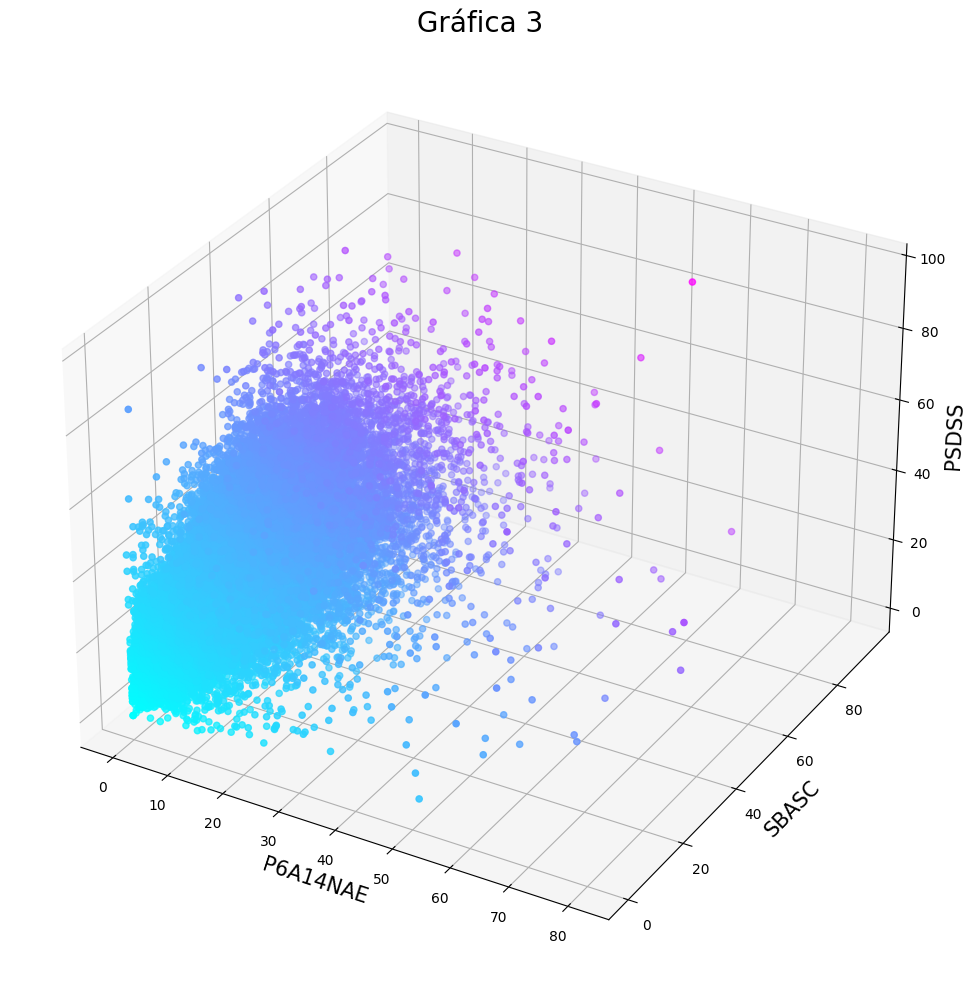

In [10]:
color_map = plt.get_cmap('cool')
plt.rcParams["figure.figsize"] = [25, 10]
plt.rcParams["figure.autolayout"] = True
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(df_FEATURES_RANK3['P6A14NAE'], df_FEATURES_RANK3['SBASC'], df_FEATURES_RANK3['PSDSS'],c=(df_FEATURES_RANK3['P6A14NAE']+ df_FEATURES_RANK3['SBASC']+ df_FEATURES_RANK3['PSDSS']),cmap = color_map)
ax.set_title('Gráfica 3', fontsize=20)
#ax.set_title('Gráfica 1: Relación entre el porcentaje de población de 6 a 14 que no asiste a la escuela, porcentaje de población de 15 años o más sin educación básica'
# 'y porcentaje de población sin derechohabiencia a los servicios de salud: 2020', fontsize=15)
ax.set_xlabel('P6A14NAE',fontsize=15,rotation=150)
ax.set_ylabel('SBASC',fontsize=15,rotation=60)
ax.set_zlabel('PSDSS',fontsize=15,rotation=60)
plt.show()

La **Gráfica 3** muestra la relación entre el porcentaje de población de 6 a 14 que no asiste a la escuela, porcentaje de población de 15 años o más sin educación básica y porcentaje de población sin derechohabiencia a los servicios de salud por AGED en el año 2020. Los puntos que están más cercanos a la esquina superior derecha al fondo, son aquellas AGEBS con mayor marginación en las variables elegidas; aquellos puntos más ceranos a la esquina inferior izquierda al frente son aquellas AGEBS con menor nivel de marginación en función de las variables elegidas.

En este caso, el **rango** de la gráfica fue un subespacio de $R^3$, mientras que el **rank** es el número de columnas linealmente independientes de la matriz *df_FEATURES_RANK3*, es decir, $3$. En este sentido, considerando que el rango de la transpuesta de nuestra matriz es igual a el rango de sí misma, dibujar el rango de _df_FEATURES_RANK3_ en la gráfica representaría dicho subespacio completo.

**2. Ajuste simple por mínimos cuadrados**
* **2.1 Decide si las columnas POB_TOT (población total) y IM_2020  de df_INDICE definen una función o no. Justifica tu respuesta.**


In [11]:
fig = px.scatter(df_INDICE,
                 x="POB_TOT", 
                 y="IM_2020", 
                 color_discrete_sequence=['indigo'], 
                 marginal_x='histogram', 
                 marginal_y='histogram',
                 opacity=0.6,
                title = 'Gráfica 4: Población total por AGEB en función del Índice de Marginación: 2020'
                )
fig.show()

**RESPUESTA:** Al realizar una gráfica de disperción de la población total en función del índice de marginación en 2020, un primer avistamiento podría dar la impresión de la relación de estas variables **no es una función**. Sin embargo, dado que el eje de las ordenadas está sumamente comprimido (tiene una escala de 10mil), podría ser que el conjunto de puntos entre los valores 100 a 130 del índice de marginación estén separados. Para saberlo, es necesario encontrar dos parejas de puntos: la primera debe cumplir que su población total sea igual, pero que su índice de marginación diferente; la segunda, que sus índices de marginación sean iguales, pero que sus valores por población sean diferentes. Así se corrobora si ambos valores pueden formar una función.

Sin embargo, considerando las **distribuciones marginales** de los ejes, que reflejan la frecuencia de puntos por cada valor del eje, hay evidencia para considerar que las columnas seleccionadas **no definen una función** porque hay un varios elemento del conjunto *IM_2020* se les asigna más de un valor del conjunto *POB_TOT*. Es decir, se incumple la definición de función.

Si se desea conocer con más precisión a qué valores del primer conjunto se les asigna más de un valor del segundo, podemos aplicar los siguientes comandos:

In [12]:
# Primero se creó un nuevo data frame que sólo incluyera las columnas *IM_2020* y *POB_TOT*
dos_feat=['POB_TOT', 'IM_2020']

df_IM2020_POBTOT=df_INDICE[dos_feat]

# Después, ordenamos el nuevo df, llamado df_IM2020_POBTOT, de menor a mayor para ambas variables:
df_IM2020_POBTOT.sort_values('POB_TOT')



,POB_TOT,IM_2020
43763,22,123.899211
18758,39,125.082429
43137,40,84.941804
36553,40,123.441738
19884,43,127.654501
...,...,...
23891,23683,123.328987
6635,24531,119.083415
8660,25213,122.205617
22706,28908,123.942147


In [13]:
df_IM2020_POBTOT.sort_values('IM_2020')

,POB_TOT,IM_2020
43737,252,53.445802
16039,140,61.210436
36854,77,62.568248
47431,192,63.888628
43727,399,64.972862
...,...,...
41453,412,127.599041
19884,43,127.654501
40800,72,127.775230
7786,513,127.866771


**CONTINUACIÓN DE LA RESPUESTA 2.2.:** 

Con los comandos 
```
df_IM2020_POBTOT.sort_values('POB_TOT')
```
y

```
df_IM2020_POBTOT.sort_values('IM_2020')
```

se ordenó el data frame *df_IM2020_POBTOT* con valores de mayor a menor: en el primer caso, en función de *POB_TOT* y en el segundo de *IM_2020*. Al consierar el primer caso, *df_IM2020_POBTOT.sort_values('POB_TOT')*, se aprecia cómo hay **dos AGEBS con población de 40 que no comparten el mismo índice de marginación**; esto significa que hay por lo menos un valor del primer conjunto *POB_TOT*, que contiene dos valores del segundo conjunto, *IM_2020*. Por lo tanto, **la relación de dichas columnas no es una función.**

Cabe agregar que definir si la relación de estas columnas era una función hubiese sido más difícil si hubiésemos ordenado los valores de menor a mayor bajo el *IM_2020*, usando el comando *df_IM2020_POBTOT.sort_values('IM_2020'), porque **es más difícil definir un valor diferente de marginación que de población, ya que la primera es una variable continua y la segunda una discreta.**

* **2.2. Agrupa todas las AGEBS por población total y asigna la media del índice de marginación de cada grupo AGEB. Decide si la relación POB_TOT → IM_2020.mean es una función.**

**RESPUESTA:** Para responder al inciso anterior, es necesario reordenar el un dataframe que contenga la poblaci[on y su respectiva índice de marginación por AGEBs con el mismo número de habitantes. Después, dados los conjuntos de misma población, obtendremos sus respectivos promedios por subconjunto.

In [ ]:
# Después, ordenamos el nuevo df, llamado df_IM2020_POBTOT, de menor a mayor para ambas variables:
df_IM2020_POBTOT.sort_values('POB_TOT')

'''Dataframe = D # = el que ya hiciste con POB_TOT,IM_2020
Size = 50790 #tamano de Dataframe en renglones 
 
DataframeM = D # = el nuevo data frame que va a tener POB_TOT, IM_2020_mean
i = 0 # renglon en el que estas parado dentro de DataframeM

for r in range(Size):
    # r es el renglon en el que estas parado dentro de Dataframe
    IM_Total_group = Dataframe[r,1]
    Gs = 1
    while Dataframe[r,0] == Dataframe[r+Gs,0]:
        IM_Total_group = Dataframe[r+Gs,1] # Actualiza el IM_Total del grupo
        Gs +=1 # Tamano de cada grupo    
    DataframeM[i,0] = Dataframe[r,0] # POB_TOT por grupos
    DataframeM[i,1] = IM_Total_group/Gs # IM_2020_mean por grupos
    r += Gs-1
    i += 1'''

In [ ]:
df_IM_mean = pd.DataFrame(columns = ['POB_TOT', 'IM_mean'])
df_IM_mean

In [ ]:
df_IM_mean = df_IM2020_POBTOT.groupby('POB_TOT')["IM_2020"].mean().reset_index(name ='IM_2020_promedio')
#df_IM_mean = df_IM2020_POBTOT.groupby("POB_TOT").mean() 
#"df_IM_mean.groupby(['IM_2020']).mean()"
#df_IM_mean = df_IM_mean.rename(columns={'POB_TOT': '1', 'IM_2020': '2'})

df_IM_mean

Otra opción era aplicar un ciclo *for* con las siguientes características:

```
df_IM_mean = pd.DataFrame(columns = ['POB_TOT', 'IM_mean'])

for r in range(50790):
     IM_Total_group = df_IM2020_POBTOT['IM_2020'][r]
     GSize = 1
     while df_IM2020_POBTOT['POB_TOT'][r] == df_IM2020_POBTOT['POB_TOT'][r+GSize]:
          IM_Total_group = df_IM2020_POBTOT['IM_2020'][r+GSize]
          GSize+= 1 # Recuerda que esto es igual a GSize=Gsize+1
     IM_mean_group = IM_Total_group/GSize
     POB_TOT_group = df_IM2020_POBTOT['POB_TOT'][r]
     new_row = {'POB_TOT':POB_TOT_group, 'IM_mean':IM_mean_group} 
     #Añadiendo una fila al dataframe
     df_IM_mean = df_IM_mean.append(new_row, ignore_index=True)
     r+=GSize-1
```

Para corroborar que la relación de la agrupación de la población por edad y su respectivo índice de marginación promedio grupal es una función, se graifcan ambas columnas para conocer su comportamiento:

In [ ]:
fig = px.scatter(df_IM_mean,
                 x="POB_TOT", 
                 y="IM_2020_promedio", 
                 color_discrete_sequence=['blue'], 
                 marginal_x='histogram', 
                 marginal_y='histogram',
                 opacity=0.6,
                title = 'Gráfica 5: índice de marginación grupal promedio en función de la agrupación de población total por AGEB: 2020'
                )
fig.show()

Las gráficas de densidad por ejes, de la gráfica 5, muestran una mayor densidad entre los valores 0 y 10mil para la variables *POP_TOT*, mientras que hay una mayor densidad entre los índices de marginación promedio de 110 y 130. Por la alta densidad del intervalo señalado de la población total, se podría pensar que hay más de un valor de *IM_2020_promedio* por cada grupo poblacional, dando la impresión de que no es una función. Sin embargo, al hacer un acercamiento a la gráfica 5 tal que la escala de la población avance cada cinco unidades en lugar de cinco mil, y la de el índide de marginación promedio por cada 0.2 unidades, notamos cómo sólo le corresponde un sólo valor del eje *y* a cada valor del eje *x*, mientras se mantienen el mimso grado de densidad para el eje *x*. Es decir, cambiando la escala de los ejes, se aprecia cómo cada valor del eje *x* tiene un sólo valor del eje *y*.

Por lo tanto, a diferencia del caso de la gráfica 4, la relación *IM_2020_promedio* y *POB_TOT* **sí es función**.

**2.3 Resuelve el problema de encontrar $\alpha$ y $\beta$ que mejor ajuste a la recta IM_2020.mean = $\alpha$ POB_TOT + $\beta$ utilizando el concepto de pseudo-inversa**.

Las diferentes librerías de Python permiten generar una regresión lineal por varios métodos:

In [ ]:
pip install scikit-learn

In [ ]:
from sklearn.linear_model import LinearRegression

In [ ]:
#data = pd.read_csv('data.csv')  # load data set
POB_TOT = df_IM_mean.iloc[:, 0].values.reshape(-1, 1)  # values converts it into a numpy array
IM_2020_promedio = df_IM_mean.iloc[:, 1].values.reshape(-1, 1)  # -1 means that calculate the dimension of rows, but have 1 column
linear_regressor = LinearRegression()  # create object for the class
linear_regressor.fit(POB_TOT, IM_2020_promedio)  # perform linear regression
IM_2020_promedio_pred = linear_regressor.predict(POB_TOT)  # make predictions

In [ ]:
plt.scatter(POB_TOT, IM_2020_promedio)
plt.plot(POB_TOT, IM_2020_promedio_pred, color='red')
plt.show()

Otra forma puede ser:

In [ ]:
fig = px.scatter(df_IM_mean, x="POB_TOT", y="IM_2020_promedio", trendline="ols",trendline_color_override="red")
fig.show()

In [ ]:
pip install statsmodels

**RESPUESTA INCISO 2.3**: Al generar un modelo de regresión lineal de la variable *IM_2020_promedio* en función de la variable *POB_TOT*, obtenemos los parámetros $\alpha$ y $\beta$ que pueden representarse por una recta roja sobre la gráfica de disperción anterior. Esta recta, con una pendiente positiva, representa el crecimiento del índice de marginación promedio en función de la población, dado un multiplicador $\alpha$, que representa la tasa de cambio de la variable dependiente respecto a la dependiente, y $\beta$, el intercepto. 

# **3. Relación lineal entre el índice de marginación urbana y los indicadores**

**3.1 Encuentra las relaciones lineales de IM_2020 con las columnas de df_FEATURES. Reporta cuidadosamente tus conclusiones. Establece las relaciones encontradas en fórmulas matemáticas específicas**.

Es necesario recordar que las once variables que forman el índice de marginación 2020, contenidas en el dataframe ```df_FEATURES```, son:

In [ ]:
df_FEATURES

P6A14NAE SBASC PSDSS OVSDE OVSEE OVSAE OVPT OVHAC OVSREF OVSINT OSCEL
Para obtener un modelo de regresión lineal de la forma

**IM_2020 = $\alpha_1$(P6A14NAE) + $\alpha_2$(SBASC) + $\alpha_3$(PSDSS) + $\alpha_3$(OVSDE) + $\alpha_4$(OVSEE) + $\alpha_5$(OVSAE) + $\alpha_6$(OVPT) + $\alpha_7$(OVHAC) + $\alpha_8$(OVSREF) + $\alpha_9$(OVSINT) + $\alpha_10$(OSCEL) + $\beta$**

se importaron las funciones `linear_model`, y `mean_squared_error` y `r2_score`, de las librerías `sklearn` y `sklearn.metrics`, respectivamente.

In [ ]:
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score

Posteriormente, se aplicaron las siguientes líneas de comando para generar los coeficientes alpha y el intercepto beta.

In [ ]:
# Se tranforma el dataframe *df_FEATURES* a una matriz y se crea una variable que contenga únicamente a la columna *IM_2020* del dataframe *df_INDICE*
matrix_FEATURES = np.array(df_FEATURES) 
IM_2020_values = df_INDICE["IM_2020"].values

# Se crea un objeto que contenga la función `linear_model.LinearRegression()`, llamada LR
LR = linear_model.LinearRegression()
 
# Se aplica el función "LR" a la matrix y columnas de interés, donde aquella contiene los datos de las once variables que 
# conforman el índice de marginación y esta los valores de la columna IM_2020 del dataframe df_INDICE
LR.fit(matrix_FEATURES, IM_2020_values)

# Finalmente, los coeficientes se obtienen con:
print('Coefficients: \n', LR.coef_)
print('Interceptor: \n', LR.intercept_)

# Hacemos la predicción con la que tendremos puntos sobre el plano hallado
# Multiplicadores = LR.predict(matrix_FEATURES)
# Error cuadrático medio
#print("Mean squared error: %.4f" % mean_squared_error(IM_2020_values, Multiplicadores))
# Evaluamos el puntaje de varianza (siendo 1.0 el mejor posible)
#print('Variance score: %.4f' % r2_score(IM_2020_values, Multiplicadores))

Por lo tanto, nuestra ecuación final tiene la forma

**IM_2020 = $-0.18093874$(P6A14NAE) + $-0.06602918$(SBASC) + $-0.07426677$(PSDSS) + $-0.2829936$(OVSDE) + $-0.33139186$(OVSEE) + $-0.076051$(OVSAE) + $-0.0989917$(OVPT) + $-0.0302336$(OVHAC) + $-0.0543476$(OVSREF) + $-0.01280568$(OVSINT) + $-0.07258523$(OSCEL) + $128.0143$**.

**Interpretación de la ecuación anterior**

El valor del índice de marginación urbana por AGEB, en el año 2020, depende de once variables y un un intercepto. De estas, la relación que guarda el índice respecto a cada una es la siguiente: por cada unidad que aumente el porcentaje de población de 6 a 14 que no asiste a la escuela, **P6A14NAE**, el índice de marginación disminuirá $-0.18093874$; por cada unidad que aumente el porcentaje de población de 15 años o más sin educación básica, **SBASC**, el índice de marginación disminuirá $-0.06602918$; respecto al porcentaje de población sin derechohabiencia a los servicios de salud (**PSDSS**), por cada unidad que éste aumente, disminuirá en $-0.07426677$ el IM; la relación del porcentaje de ocupantes en viviendas sin drenaje ni excusado (**OVSDE**) y el índice de marginación en 2020 tienen una relación negativa por $-0.2829936$; por cada unidad que aumente el porcentaje de ocupantes en viviendas sin energía eléctrica **(OVSEE)**, dismunye el índice de marginación en $-0.33139186$; en el caso del porcentaje de ocupantes en viviendas sin agua entub **(OVSAE)**, cuando este aumenta en una unidad, el índice de marginación disminuye en $-0.076051$; también con una relación negativa, cuando el porcentaje de ocupantes en viviendas con piso de tierra aumenta **(OVPT)**, el índide de marginación disminuye en $-0.0989917$; cuando el porcentaje de ocupantes en viviendas con hacinamiento **(OVHAC)** disminuye en una unidad, el índice de marginación disminuye $-0.0302336$ unidades; cuando el porcentaje de ocupantes en viviendas sin refrigerador **(OVSREF)** aumenta en una unidad, el índice disminuye en $-0.0543476$; en el caso del porcentaje de ocupantes en viviendas sin internet **(OVSINT)**, tiene una relación negativa de $-0.01280568$ con el índice de marginación, y el porcentaje de población sin celular afecta inversamente en $-0.07258523$ unidades al índice de marginación.

Se aprecia entonces cómo todas las variavles tiene una relación negativa con el Índice de marginación 2020. Esto tiene sentido, pues, en cuanto más alto sean las carencias, menor será el índice y, por lo tanto, mayor será el grado de marginación.

# **4. Análsis de componentes principales**
* **4.1 Aplica el procedimiento de componentes principales a la matriz df_FEATURES usando la paquetería PCA de sklearn.decomposition y define un índice alternativo IM_2020_ALT definido como la primera componente. En términos lineales ¿qué tan distintos son IM_2020 e IM_2020_ALT?**

Antes de aplicar *pricipal componente analysis*, debe importarse la siguiente función:

In [ ]:
from sklearn.decomposition import PCA

Después, con las siguientes líneas de código se construye el PCA con $1$ componente.

In [ ]:
scaler = StandardScaler()
features_std = scaler.fit_transform(df_FEATURES)

pca = PCA(n_components=1)
IM_2020_ALT = pca.fit_transform(features_std)
IM_2020_ALT = pd.DataFrame(IM_2020_ALT)
IM_2020_ALT

Las siguientes lineas de comando resultan en la media y desviación estandar de las componentes seleccionadas. Se aplicó `n_componentes  =  11` para conocer los valores correspondientes de las once columnas del dataframe `df_FEATURES`. Sin embargo, esto no era necesario para responder la pregunta del inciso 1 en la sección 4.

In [ ]:
# Se utiliza la matriz "matrix_FEATURES" creada previamente:
pca = PCA(n_components=11)
pca.fit(matrix_FEATURES)
PCA(n_components=11)
print(pca.explained_variance_ratio_)
# [0.65575087 0.08479898]
print(pca.singular_values_)
# [7270.97626634 2614.68037669]

In [ ]:
df_INDICE.IM_2020

Generamos un nuevo data frame que contenga tres columnas: `ENT`, referente a Entidad; `IM_2020`, referente al indice de marginación 2020; e `IM_2020_ALT`, que es el índice de marginación 2020 alternativo. El nuevo dataframe es `df_IM2020_IM2020_ALT`

In [ ]:
features_3 = ['NOM_ENT','IM_2020']
df_IM2020_IM2020_ALT = df_INDICE[features_3]
df_IM2020_IM2020_ALT.insert(loc=2,
          column='IM_2020_ALT',
          value= IM_2020_ALT[0] )
df_IM2020_IM2020_ALT = df_IM2020_IM2020_ALT.groupby(['NOM_ENT'], as_index = False).mean()
df_IM2020_IM2020_ALT

In [ ]:
df_IM2020_IM2020_ALT['IM_2020']=df_IM2020_IM2020_ALT['IM_2020']/100
ax = df_IM2020_IM2020_ALT.plot.barh()
index = df_IM2020_IM2020_ALT['NOM_ENT']

En la gráfica anterior se aprecian ambos índices de marginación, `IM_2020` y `IM_2020_ALT`, donde el primero está dividido entre 100 para apreciar mejor ambas escalas en una sola gráfica. Ambos se diferencian en la **escala**: mientras el `IM_2020`tiene ronda por valores entre $115$ (valor mínimo correspondiente a Oaxaca) y $122$ (valor máximo correspondiente a Nuevo León), el `IM_2020_ALT`ronda entre $-1.32$ (valor mínimo correspondiente a Nuevo León) y $2.42$ (valor máximo correspondiente a Oaxaca), y sus lecturas son inversas. El `IM_2020` tiene una relación inversa con el nivel de marginación, donde, entre más alto sea el índice de marginación 2020, menos es el grado de marginación. El `IM_2020_ALT` tiene una relación directa con el nivel de marginación, donde, entre más alto sea el índice, más alto es el grado de marginación.

In [ ]:
"ax = df_IM2020_IM2020_ALT['IM_2020_ALT'].plot.barh()"
"index = df_IM2020_IM2020_ALT['NOM_ENT']"

**4.1. Estudia las relaciones lineales del IM_2020 con todas las componentes. *Hint* : Proyecta con la pseudo-inversa a IM_2020 sobre las componentes. Saca la matriz de correlación de IM_2020_ALT con IM_2020.**

La indicación de este inciso puede reescribirse **como encontrar una ecuación donde se expresen las relaciones de las columnas de la matriz `df_FEATURES`**. Es decir:

$IM_{2020}= x_1 (P6A14NAE)+ x_2 (SBASC) +\ldots + x_{11} (OSCEL)$

La ecuación anterior es equivalente a encontrar $\min_{x} = \Vert Ax - b\Vert^{2}$, lo cual es aplicable al caso de `df_FEATURES` como:

$\min_{x} = \Vert df_{FEATURES} \space x - IM_{2020}\Vert ^{2}$.

Este problema puede resolverse aplicando la **Pseudoinversa de Moore-Penrose**. Además, dado que la matriz `df_FEATURES` es de dimensión $50790 × 11$, particualmente es posible bajo el caso donde $A$ es *full column rank*. Éste señala que

**Si A es full column rank $(r=m, m<n)$, entonces $A^+ = A_{left}^{-1} : \R^{n} \rightarrow \R$ y se alcanza el mínimo del problema $\min_{x} = \Vert Ax - b\Vert^{2}$ en un único punto en $R^m:$**

**$x^+ = A^+\space b = (A^{T}A)^{-1}A^{T}b$**

Reescribiendo el caso donde $A$ es *full column rank* con las variables de `df_FEATURES`, la ecuación se reescribe como:

$x^+ = df_{FEATURES}^+\space IM_{2020} = (df_{FEATURES}^{T}\space df_{FEATURES})^{-1}df_{FEATURES}^{T} \space IM_{2020}$

Para resolver la ecuación donde $A$ es *full column rank*, primero calculamos la transpuesta de la matriz de interés y obtenemos el producto de esta por la matriz original. El resultado se nombre `matrix_FEATURES_2`.

In [ ]:
matrix_FEATURES.transpose()
matrix_FEATURES_2 = np.matmul(matrix_FEATURES.transpose(), matrix_FEATURES)
matrix_FEATURES_2

Lo siguiente es calcular la inversa de `matrix_FEATURES_2`. Se nombrará como `matrix_FEATURES_3`.

In [ ]:
matrix_FEATURES_3 =  np.linalg.inv(matrix_FEATURES_2)
matrix_FEATURES_3

Luego, multiplicamos `matrix_FEATURES_3` por la transpuesta de `matrix_FEATURES`

In [ ]:
matrix_FEATURES_4 = np.matmul(matrix_FEATURES_3, matrix_FEATURES.transpose())
matrix_FEATURES_4

Finalmente, multiplicamos `matrix_FEATURES_4` y por el vector `IM_2020` (este debe ser escrito en el código como un arreglo, no como una columna de un dataframe). El resultado final será nombrado $x$.

In [ ]:
x = np.matmul(matrix_FEATURES_4, df_INDICE['IM_2020'])
x

El arreglo $x$ representa las $11$ compontnes que satisfacen la ecuación $IM_{2020}= x_1 (P6A14NAE)+ x_2 (SBASC) +\ldots + x_{11} (OSCEL)$. Usando las componentes del arreglo $x$, esta ecuación se reescribe como

$IM_{2020}= 1.52552093 (P6A14NAE)+ 0.20761029 (SBASC) +\ldots + 0.81715055 (OSCEL)$,

donde se muestran las relaciones lineales del `IM_2020`.

Para comprobar el resultado obtenido, se multiplica la matrix `df_FEATURES` por el arreglo $x$. El resultado es un vector columna sumamente similar a `IM_2020`.

In [ ]:
print(np.matmul(df_FEATURES, x))

**4.2. Según la documentación de sklearn https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html la función inverse_transform «Transform data back to its original space». Describe matemáticamente qué hace exactamente este procedimiento, describe con cuidado las diferencias entre calcular todos los componentes o solo, digamos 2 a partir de usar el comando pca = PCA(n_components=2). Corrige la respuesta dada en: https://stackoverflow.com/questions/55533116/pca-inverse-transform-in-sklearn sobre esta pregunta relacionada. La respuesta es aproximada, está incompleta y falta precisión. Escribe una respuesta definitiva. Hint : toma en cuenta la desomposición de valores singulares y su relación con PCA**

## **Bibliografía**
* Aprende Machine Learning. (2020, December 19). *Ejemplo Regresión Lineal Python*. https://www.aprendemachinelearning.com/regresion-lineal-en-espanol-con-python/
* Choosing Colormaps in Matplotlib — Matplotlib 3.6.0 documentation. (n.d.). Retrieved November 1, 2022, from https://matplotlib.org/stable/tutorials/colors/colormaps.html
* CONAPO. (n.d.). *Anexo C Metodología de estimación del índice de marginación*. Comisión Nacional De Población. Retrieved November 17, 2022, from https://www.gob.mx/cms/uploads/attachment/file/459289/07_Anexo_C.pdf
* Menon, A. (n.d.). *Linear Regression in 6 lines of Python*. Towardsdatascience. Retrieved November 11, 2022, from https://towardsdatascience.com/linear-regression-in-6-lines-of-python-5e1d0cd05b8d
* Martínez, C. (2019, September 27). *RPubs - Análisis de componentes principales (PCA)*. https://rpubs.com/Cristina_Gil/PCA
* Plotly.com (n.d.). Linear and Non-Linear Trendlines in Python. Plotly. Retrieved November 11, 2022, from https://plotly.com/python/linear-fits/
* Ocampo, D. V. (n.d.). *ACP utilizando el índice de marginación*. https://rstudio-pubs-static.s3.amazonaws.com/747844_c2082be834e4454fbca1219e58855566.html